# -- Average All Seeds for Turbine Data --

In [69]:
import sys

#sys.path.append("/Volumes/pdoubraw-1/repos/ABLTools/python/")
sys.path.append("C:/Users/krydalch/Documents/Repos/ABLtools_python/")

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import glob, os
import functions as f
import stochasticTurbulenceTools as stt


sys.path.append("C:/Users/krydalch/Documents/Repos/")
from datatools import wfip2
from datatools.remote_sensing import scintec_profiler

from scipy.signal import welch

import seaborn as sns


plt.rc("font",size=14)

## Create DF from all turbine data

In [54]:
dat = {}
turbines =  ["1MW","5MW","10MW"]
for period_name,period_time in zip(["Jet","Mixed"],["1440","1820"]):
    print(period_name)
    dat[period_name] = {}
    for turbine in turbines:
        dat[period_name][turbine] = {}
        for seed in range(1,7):
            file_path = "C:/Users/krydalch/Desktop/OPENfast/Outputs (jet.out)/{0}_{1}_rand{2}.out".format(turbine, period_time, seed)
            dat[period_name][turbine][seed] = pd.read_csv(file_path,skiprows = 4, header = [1,2], sep = '\s+', index_col=[0])
            dat[period_name][turbine][seed] = dat[period_name][turbine][seed].loc[200:]
            
for period_name,period_time in zip(["Jet","Mixed"],["1440","1820"]):
    for turbine in turbines:
        dat[period_name][turbine]["mean"] = pd.concat([dat[period_name][turbine][seed] for seed in range(1,7)]).groupby(level=0).mean().copy()
print("DONE!")

Jet
Mixed
DONE!


In [128]:
for period_name,period_time in zip(["Jet","Mixed"],["1440","1820"]):
    for turbine in turbines:
        df_now = dat[period_name][turbine]["mean"]
        
        path_to_csv = 'C:/Users/krydalch/Desktop/OPENfast/means/{0}_{1}_mean.csv'.format(turbine,period_name)
        df_now.to_csv(path_to_csv)

        


# Analyze Data

In [20]:
cols = ['B1Pitch', 'BlPitch1', 'BlPitch2', 'BlPitch3', 'GenPwr', 'GenTq', 'HSShftTq', 'LSShftFxa', 'LSShftMxa', 'RootFxb1', 'RootFxb2', 'RootFxb3', 'RootFyb1', 'RootFyb2', 'RootFyb3', 'RotPwr', 'RtAeroCp', 'RtAeroCq', 'RtAeroCt', 'RtAeroFxh', 'RtAeroFyh', 'RtAeroMxh', 'RtAeroMyh', 'RtAeroMzh', 'RtAeroPwr', 'RtSkew', 'RtSpeed', 'RtTSR', 'RtVAvgxh', 'RtVAvgyh', 'RtVAvgzh', 'TwrBsFxt', 'TwrBsFyt', 'TwrBsFzt', 'TwrBsMxt', 'TwrBsMyt', 'TwrBsMzt', 'Wind1VelX', 'Wind1VelY', 'Wind1VelZ', 'YawBrRDxt', 'YawBrRDyt', 'YawBrRDzt', 'YawBrTDxt', 'YawBrTDyt']       


In [6]:
fig_labels = {'RootFxb1':"Force at Blade Root along $x$ [N]"}
colors     = {"jet":'r',"mixed":'g'}

## PLOTS

In [16]:
period_name

'Mixed'

In [15]:
dat[period_name][turbine]["mean"].head()

Time,Wind1VelX,Wind1VelY,Wind1VelZ,Wind2VelX,Wind2VelY,Wind2VelZ,Wind3VelX,Wind3VelY,Wind3VelZ,Wind4VelX,...,RtAeroFxh,RtAeroFyh,RtAeroMxh,RtAeroMyh,RtAeroMzh,BlPitchC1,BlPitchC2,BlPitchC3,GenTq,GenPwr
(s),(m/s),(m/s),(m/s),(m/s),(m/s),(m/s),(m/s),(m/s),(m/s),(m/s),...,(N),(N),(N-m),(N-m),(N-m),(deg),(deg),(deg),(kN-m),(kW)
200.00,10.166500,-0.722323,0.005510,12.056667,-1.289153,-0.378248,12.033333,-0.819200,0.237983,10.538833,...,690083.333333,6483.333333,6.751000e+06,-1.065733e+06,249883.333333,0.0,0.0,0.0,129.916667,4413.000000
200.05,10.169667,-0.673358,0.005657,12.010000,-1.216100,-0.396835,11.860000,-0.950867,0.315832,10.468667,...,685350.000000,7642.500000,6.724833e+06,-1.179257e+06,234650.000000,0.0,0.0,0.0,129.983333,4415.333333
200.10,10.259333,-0.737400,0.036323,12.058333,-1.348983,-0.374387,11.818333,-0.936267,0.212433,10.429667,...,689333.333333,7027.000000,6.740000e+06,-1.059435e+06,315331.666667,0.0,0.0,0.0,130.033333,4417.333333
200.15,10.282000,-0.698233,0.061225,12.015000,-1.518917,-0.374038,11.801667,-0.928400,0.306783,10.418833,...,684883.333333,6349.500000,6.731167e+06,-9.243500e+05,261566.666667,0.0,0.0,0.0,130.050000,4418.666667
200.20,10.217667,-0.696433,0.114652,12.020000,-1.535100,-0.272007,11.755000,-0.910450,0.256652,10.475000,...,685583.333333,7387.833333,6.712833e+06,-1.101850e+06,309569.833333,0.0,0.0,0.0,130.100000,4419.833333


## NORMAL PLOTS FOR ALL 3 Turbines

In [21]:
fig,axs = plt.subplots(len(cols),3,figsize=(40,400))

turbines =  ["1MW","5MW","10MW"]
for i,varname in enumerate(cols):
    for j,turbine in enumerate(turbines):
        axs[i,j].plot(dat['Mixed'][turbine]["mean"][varname],'b')
        axs[i,j].plot(dat["Jet"][turbine]["mean"][varname],'r',alpha=0.6)
        axs[i,j].set_ylabel(varname)
        axs[i,j].set_title(turbine)
        
        

    
#     print(period_name)
#     for turbine in turbines:
#         dat[period_name][turbine] = {}

## BOX PLOTS

In [3]:
cols = ['B1Pitch', 'BlPitch1', 'BlPitch2', 'BlPitch3', 'GenPwr', 'GenTq', 'HSShftTq', 'LSShftFxa', 'LSShftMxa', 'RootFxb1', 'RootFxb2', 'RootFxb3', 'RootFyb1', 'RootFyb2', 'RootFyb3', 'RotPwr', 'RtAeroCp', 'RtAeroCq', 'RtAeroCt', 'RtAeroFxh', 'RtAeroFyh', 'RtAeroMxh', 'RtAeroMyh', 'RtAeroMzh', 'RtAeroPwr', 'RtSkew', 'RtSpeed', 'RtTSR', 'RtVAvgxh', 'RtVAvgyh', 'RtVAvgzh', 'TwrBsFxt', 'TwrBsFyt', 'TwrBsFzt', 'TwrBsMxt', 'TwrBsMyt', 'TwrBsMzt', 'Wind1VelX', 'Wind1VelY', 'Wind1VelZ', 'YawBrRDxt', 'YawBrRDyt', 'YawBrRDzt', 'YawBrTDxt', 'YawBrTDyt']       

colors = {'Jet': {'1MW': '#ff6666','5MW': '#ff0000','10MW': '#990000'}, 'Mixed' : {'1MW': '#8fa1ca','5MW': '#204395','10MW': '#132859'}}

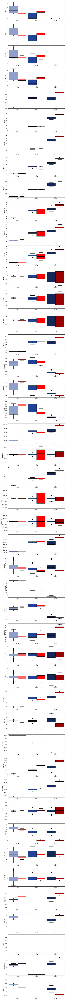

In [14]:
fig,ax = plt.subplots(len(cols),1,figsize=(10,180))
#fig.suptitle('BOX PLOTS FOR 1MW, 5MW, & 10MW TURBINES', fontsize=16)

j = 0
box_width = 0.45
for varname in cols:
    for period_name in ["Jet","Mixed"]:
        for i,turbine in enumerate(turbines):
            param = 1 if period_name=="Jet" else -1 
            data_to_plot = np.squeeze(dat[period_name][turbine]["mean"][varname].values)

#             if varname=='GenPwr':
#                 rated_power = float(turbine.split('MW')[0])
#                 rated_power = 3.6 if rated_power==3.0 else rated_power
#                 data_to_plot = (data_to_plot/1000.0)/rated_power

            ax[j].boxplot(data_to_plot, positions=[(i+1)+param*box_width/2.0], widths=[box_width],
                       patch_artist=True,boxprops=dict(facecolor=colors[period_name][turbine], color='black'),
                       capprops=dict(color='k'),whiskerprops=dict(color='k'),flierprops=dict(color='k', markeredgecolor='k'),
                       medianprops=dict(color='k'))


        

    ax[j].set_xticks([1,2,3])
    ax[j].set_xticklabels(turbines)
    #ax.set_xlim([0.25,3.75])
    ax[j].set_xlim([0.5,3.5])
    ax[j].set_ylabel(varname)
    j = j+1

#fig.savefig("../disk-averaged relative wind velocity.png",bbox_inches="tight",dpi=500)

In [35]:
data_to_plot

array([11.53333333, 11.535     , 11.53833333, ..., 11.65      ,
       11.64666667, 11.63166667])

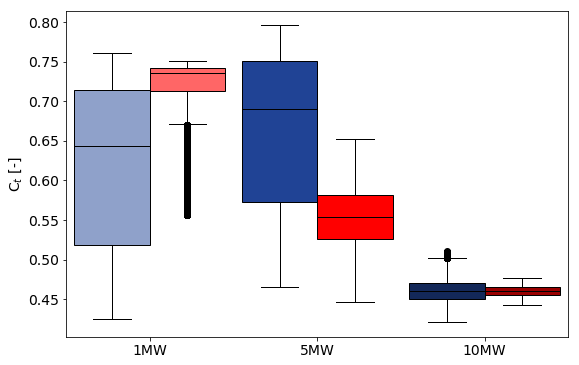

In [52]:
mean_dat_llj = []
mean_dat_mix = []

plt.rc("font",size=14)
varname = 'RtAeroCt'

fig = plt.figure(1, figsize=(9, 6))
ax  = fig.add_subplot(111)
box_width = 0.45

for period_name in ["Jet","Mixed"]:
    for i,turbine in enumerate(turbines):
        param = 1 if period_name=="Jet" else -1 
        data_to_plot = np.squeeze(dat[period_name][turbine]["mean"][varname].values)
        
        if period_name == "Jet":
            mean_dat_llj =  np.append(mean_dat_llj , np.mean(data_to_plot))
            
        if period_name == "Mixed":
            mean_dat_mix =  np.append(mean_dat_mix , np.mean(data_to_plot))

        
        if varname=='GenPwr':

            if turbine == '1MW':
                rated_power = float(1.5)
                data_to_plot = (data_to_plot/1000.0)/rated_power
            else:
                rated_power = float(turbine.split('MW')[0])
                rated_power = 3.6 if rated_power==3.0 else rated_power
                data_to_plot = (data_to_plot/1000.0)/rated_power
                
                
            
            
        ax.boxplot(data_to_plot, positions=[(i+1)+param*box_width/2.0], widths=[box_width],
                   patch_artist=True,boxprops=dict(facecolor=colors[period_name][turbine], color='black'),
                   capprops=dict(color='k'),whiskerprops=dict(color='k'),flierprops=dict(color='k', markeredgecolor='k'),
                   medianprops=dict(color='k'))


        

ax.set_xticks([1,2,3])
ax.set_xticklabels(turbines)
#ax.set_xlim([0.25,3.75])
ax.set_xlim([0.5,3.5])
ax.set_ylabel('C$_t$ [-]')

fig.savefig("../ThrustCoef.png",bbox_inches="tight",dpi=500)

In [53]:
(mean_dat_llj - mean_dat_mix)/mean_dat_mix *100

array([ 16.34366982, -16.60314418,  -0.24220852])

In [46]:
(mean_dat_llj - mean_dat_mix)/mean_dat_mix *100

array([14.22324349, -3.4503989 , 39.98068106])

Text(0, 0.5, 'Tower base pitching moment [MN*m]')

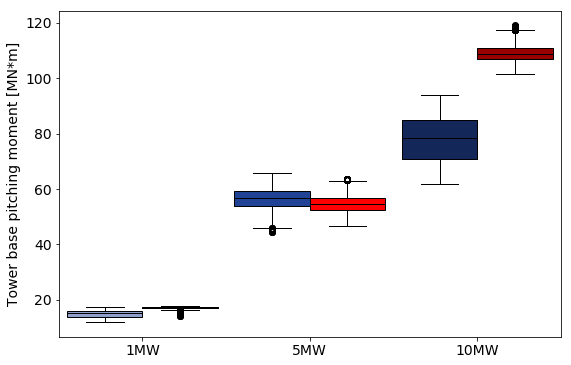

In [33]:
plt.rc("font",size=14)
varname = 'TwrBsMyt'

fig = plt.figure(1, figsize=(9, 6))
ax  = fig.add_subplot(111)
box_width = 0.45

for period_name in ["Jet","Mixed"]:
    for i,turbine in enumerate(turbines):
        param = 1 if period_name=="Jet" else -1 
        data_to_plot = np.squeeze(dat[period_name][turbine]["mean"][varname].values)
        
        if varname=='GenPwr':
            rated_power = float(turbine.split('MW')[0])
            rated_power = 3.6 if rated_power==3.0 else rated_power
            data_to_plot = (data_to_plot/1000.0)/rated_power
            
        ax.boxplot(data_to_plot/1000, positions=[(i+1)+param*box_width/2.0], widths=[box_width],
                   patch_artist=True,boxprops=dict(facecolor=colors[period_name][turbine], color='black'),
                   capprops=dict(color='k'),whiskerprops=dict(color='k'),flierprops=dict(color='k', markeredgecolor='k'),
                   medianprops=dict(color='k'))


        

ax.set_xticks([1,2,3])
ax.set_xticklabels(turbines)
#ax.set_xlim([0.25,3.75])
ax.set_xlim([0.5,3.5])
ax.set_ylabel('Tower base pitching moment [MN*m]')

#fig.savefig("../TowerBasePitchingMoment.png",bbox_inches="tight",dpi=500)

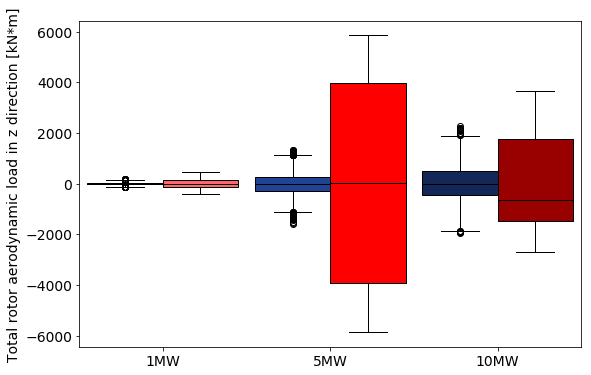

In [34]:
plt.rc("font",size=14)
varname = 'RtAeroMzh'

fig = plt.figure(1, figsize=(9, 6))
ax  = fig.add_subplot(111)
box_width = 0.45

for period_name in ["Jet","Mixed"]:
    for i,turbine in enumerate(turbines):
        param = 1 if period_name=="Jet" else -1 
        data_to_plot = np.squeeze(dat[period_name][turbine]["mean"][varname].values)
        
        if varname=='GenPwr':
            rated_power = float(turbine.split('MW')[0])
            rated_power = 3.6 if rated_power==3.0 else rated_power
            data_to_plot = (data_to_plot/1000.0)/rated_power
            
        ax.boxplot(data_to_plot/1000, positions=[(i+1)+param*box_width/2.0], widths=[box_width],
                   patch_artist=True,boxprops=dict(facecolor=colors[period_name][turbine], color='black'),
                   capprops=dict(color='k'),whiskerprops=dict(color='k'),flierprops=dict(color='k', markeredgecolor='k'),
                   medianprops=dict(color='k'))


        

ax.set_xticks([1,2,3])
ax.set_xticklabels(turbines)
#ax.set_xlim([0.25,3.75])
ax.set_xlim([0.5,3.5])
ax.set_ylabel('Total rotor aerodynamic load in z direction [kN*m]')

#fig.savefig("../RotorLoad.png",bbox_inches="tight",dpi=500)

Text(0, 0.5, 'C$_p$ [-]')

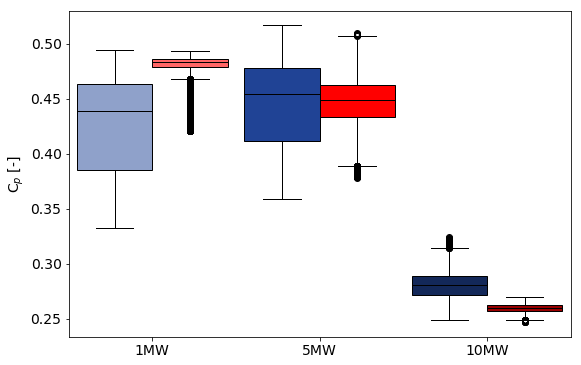

In [35]:
plt.rc("font",size=14)
varname =  'RtAeroCp'

fig = plt.figure(1, figsize=(9, 6))
ax  = fig.add_subplot(111)
box_width = 0.45

for period_name in ["Jet","Mixed"]:
    for i,turbine in enumerate(turbines):
        param = 1 if period_name=="Jet" else -1 
        data_to_plot = np.squeeze(dat[period_name][turbine]["mean"][varname].values)
        
        if varname=='GenPwr':
            rated_power = float(turbine.split('MW')[0])
            rated_power = 3.6 if rated_power==3.0 else rated_power
            data_to_plot = (data_to_plot/1000.0)/rated_power
            
        ax.boxplot(data_to_plot, positions=[(i+1)+param*box_width/2.0], widths=[box_width],
                   patch_artist=True,boxprops=dict(facecolor=colors[period_name][turbine], color='black'),
                   capprops=dict(color='k'),whiskerprops=dict(color='k'),flierprops=dict(color='k', markeredgecolor='k'),
                   medianprops=dict(color='k'))


        

ax.set_xticks([1,2,3])
ax.set_xticklabels(turbines)
#ax.set_xlim([0.25,3.75])
ax.set_xlim([0.5,3.5])
plt.rc("font",size=18)
ax.set_ylabel('C$_p$ [-]')

#fig.savefig("../PowerCoef.png",bbox_inches="tight",dpi=500)


## PSD Related to Turbines

#### Need to Figure out Blade Passing Frequency for each turbine

In [107]:
var = 'RtSpeed'
rps = {}

for turbine in turbines:
    series = dat['Jet'][turbine]["mean"][var]
    rpm_mean = series.mean()
    rpm_mean = rpm_mean[0]
    rps[turbine] = rpm_mean/60
type(float(rps[turbine]))
    

float

In [108]:
fig,axs = plt.subplots(len(cols),3,figsize=(40,400))

turbines =  ["1MW","5MW","10MW"]
for i,varname in enumerate(cols):
    for j,turbine in enumerate(turbines):
        
        # MIXED
        series_mixed = dat['Mixed'][turbine]["mean"][varname]
        series_mixed = series_mixed - series_mixed.mean()
        dt_mixed = series_mixed.index[1] - series_mixed.index[0]
        fs = 1/dt_mixed
        timeseries = series_mixed.values.T
        [f_mixed,P_mixed]=welch(timeseries,fs=fs)
        
        # JET
        series_jet = dat['Jet'][turbine]["mean"][varname]
        series_jet = series_jet - series_jet.mean()
        dt_jet =series_jet.index[1] - series_jet.index[0]
        fs = 1/dt_jet
        timeseries = series_jet.values.T
        [f_jet,P_jet]=welch(timeseries,fs=fs)
        
        axs[i,j].plot(f_mixed,P_mixed[0],'b')
        axs[i,j].plot(f_jet,P_jet[0],'r',alpha=0.6)
        axs[i,j].set_ylabel(varname)
        axs[i,j].set_xlabel('Freq [Hz]')
        axs[i,j].set_title(turbine)
        #axs[i,j].set_xticks([-0.1, 0, 0.25, 0.5, 0.75, 1, 1.25, 1.5, 1.75, 2, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5, 3.75, 4.0, 4.25, 4.5, 4.75, 5.0, 5.25])
        axs[i,j].set_xlim(left = 0,right = 5.25)
        axs[i,j].axvline(x=float(rps[turbine]),linestyle = '--', alpha = 0.3)
        
        

In [84]:
len(f_mixed)

129

In [83]:
len(P_mixed[0])

129

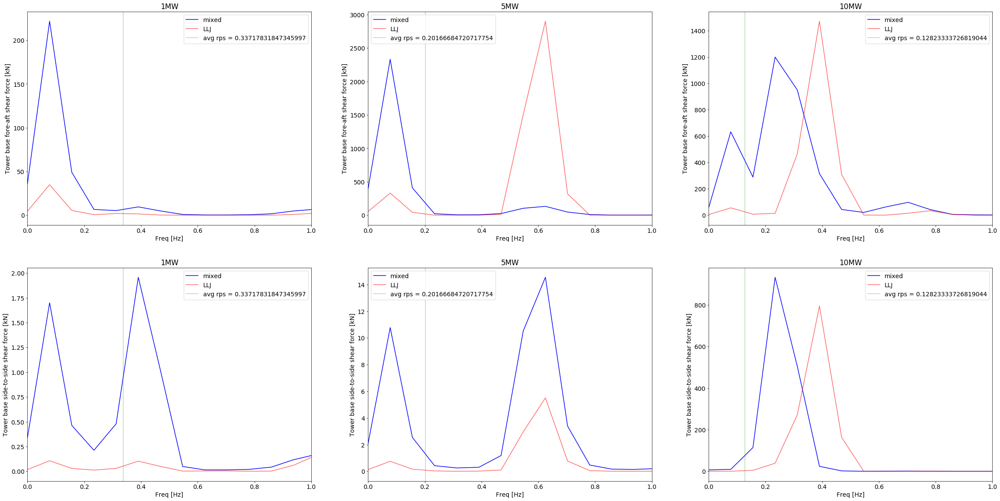

In [127]:
#'TwrBsFxt', 'TwrBsFyt', 'TwrBsFzt'
cols = ['TwrBsFxt', 'TwrBsFyt']

fig,axs = plt.subplots(len(cols),3,figsize=(40,20))

turbines =  ["1MW","5MW","10MW"]
for i,varname in enumerate(cols):
    for j,turbine in enumerate(turbines):
        
        # MIXED
        series_mixed = dat['Mixed'][turbine]["mean"][varname]
        series_mixed = series_mixed - series_mixed.mean()
        dt_mixed = series_mixed.index[1] - series_mixed.index[0]
        fs = 1/dt_mixed
        timeseries = series_mixed.values.T
        [f_mixed,P_mixed]=welch(timeseries,fs=fs)
        
        # JET
        series_jet = dat['Jet'][turbine]["mean"][varname]
        series_jet = series_jet - series_jet.mean()
        dt_jet =series_jet.index[1] - series_jet.index[0]
        fs = 1/dt_jet
        timeseries = series_jet.values.T
        [f_jet,P_jet]=welch(timeseries,fs=fs)
        
        axs[i,j].plot(f_mixed,P_mixed[0],'b', label = 'mixed')
        axs[i,j].plot(f_jet,P_jet[0],'r',alpha=0.6, label = 'LLJ')
        if i == 0:
            axs[i,j].set_ylabel('Tower base fore-aft shear force [kN]')
        else:
            axs[i,j].set_ylabel('Tower base side-to-side shear force [kN]')
            
        axs[i,j].set_xlabel('Freq [Hz]')
        axs[i,j].set_title(turbine)
        #axs[i,j].set_xticks([-0.1, 0, 0.25, 0.5, 0.75, 1, 1.25, 1.5, 1.75, 2, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5, 3.75, 4.0, 4.25, 4.5, 4.75, 5.0, 5.25])
        axs[i,j].set_xlim(left = 0,right = 1)
        axs[i,j].axvline(x=float(rps[turbine]),linestyle = '-',color = 'g', alpha = 0.3, label = 'avg rps = {0}'.format(rps[turbine]))
        axs[i,j].legend()
fig.savefig("../TWR_forces.png",bbox_inches="tight",dpi=500)        

# Test VEER 

#### Import Mean data for JET and MIXED

In [111]:
jet_10mw = dat['Jet']['10MW']['mean']
mix_10mw = dat['Mixed']['10MW']['mean']

jet_5mw = dat['Jet']['5MW']['mean']
mix_5mw = dat['Mixed']['5MW']['mean']

#### Import Veer Data

In [8]:
############### 10 MW ############################
# Mixed Period VEER
file_path = "C:/Users/krydalch/Desktop/OPENfast/Outputs (jet.out)/10MW_1820_veer.out"
mix_veer_10mw = pd.read_csv(file_path,skiprows = 4, header = [1,2], sep = '\s+', index_col=[0])
mix_veer_10mw= mix_veer_10mw.loc[200:]
# Jet Period VEER
file_path = "C:/Users/krydalch/Desktop/OPENfast/Outputs (jet.out)/10MW_1440_veer.out"
jet_veer_10mw = pd.read_csv(file_path,skiprows = 4, header = [1,2], sep = '\s+', index_col=[0])
jet_veer_10mw= jet_veer_10mw.loc[200:]

############### 5 MW ############################
# Mixed Period VEER
file_path = "C:/Users/krydalch/Desktop/OPENfast/Outputs (jet.out)/5MW_1820_veer.out"
mix_veer_5mw = pd.read_csv(file_path,skiprows = 4, header = [1,2], sep = '\s+', index_col=[0])
mix_veer_5mw= mix_veer_5mw.loc[200:]
# Jet Period VEER
file_path = "C:/Users/krydalch/Desktop/OPENfast/Outputs (jet.out)/5MW_1440_veer.out"
jet_veer_5mw = pd.read_csv(file_path,skiprows = 4, header = [1,2], sep = '\s+', index_col=[0])
jet_veer_5mw= jet_veer_5mw.loc[200:]

In [9]:
keys_bees = ['B1Pitch', 'BlPitch1', 'BlPitch2', 'BlPitch3', 'GenPwr', 'GenTq', 'HSShftTq', 'LSShftFxa', 'LSShftMxa', 'RootFxb1', 'RootFxb2', 'RootFxb3', 'RootFyb1', 'RootFyb2', 'RootFyb3', 'RotPwr', 'RtAeroCp', 'RtAeroCq', 'RtAeroCt', 'RtAeroFxh', 'RtAeroFyh', 'RtAeroMxh', 'RtAeroMyh', 'RtAeroMzh', 'RtAeroPwr', 'RtSkew', 'RtSpeed', 'RtTSR', 'RtVAvgxh', 'RtVAvgyh', 'RtVAvgzh', 'TwrBsFxt', 'TwrBsFyt', 'TwrBsFzt', 'TwrBsMxt', 'TwrBsMyt', 'TwrBsMzt', 'Wind1VelX', 'Wind1VelY', 'Wind1VelZ', 'YawAzn', 'YawBrRDxt', 'YawBrRDyt', 'YawBrRDzt', 'YawBrTDxt', 'YawBrTDyt', 'YawBrTDzt', 'YawPzn', 'YawVzn']

## Plot Varnames

In [11]:
fig,axs = plt.subplots(len(keys_bees),2,figsize=(40,400))

i = 0
for varnmae in keys_bees:
    # left side
    axs[i,0].plot(mix_10mw[varnmae],'b',label='mix')
    axs[i,0].plot(mix_veer_10mw[varnmae],'c--',alpha=0.6,label='mix-veer')
    
    axs[i,0].plot(jet_10mw[varnmae],'r',label='jet')
    axs[i,0].plot(jet_veer_10mw[varnmae],'g--',alpha=0.6,label='jet-veer')
    
    axs[i,0].set_ylabel(varnmae)
    axs[i,0].set_title('10MW')
    axs[i,0].legend()
    
    # right side
    axs[i,1].plot(mix_5mw[varnmae],'b',label='mix')
    axs[i,1].plot(mix_veer_5mw[varnmae],'c--',alpha=0.6,label='mix-veer')
    
    axs[i,1].plot(jet_5mw[varnmae],'r',label='jet')
    axs[i,1].plot(jet_veer_5mw[varnmae],'g--',alpha=0.6,label='jet-veer')
    
    axs[i,1].set_ylabel(varnmae)
    axs[i,1].set_title('5MW')
    axs[i,1].legend()
    
    i = i +1

In [ ]:
12*3 + 12

In [105]:
(12*120 + 36*30)/60

42.0